In [1]:
from pathlib import Path

mp3_dir = Path.cwd().parent / "data"
sep_dir = mp3_dir / "split"
embs_dir = mp3_dir / "embs"
figs_dir = mp3_dir / "figs"
figs_dir.mkdir(exist_ok=True)
assert embs_dir.exists()

In [2]:
from matplotlib import pyplot as plt
import re
import torch
import warnings
import librosa

In [3]:
def parse_time(filename):
    # Extract the base name without the "_separated_accompaniment" or "_separated_vocals" suffix
    base_name = re.sub(r"(_from-\d+s|_\d+m\d+s|_\d+(ms|s)-clip)?(_separated_(accompaniment|vocals))?$", "", filename)

    # Determine the type of separation (accompaniment or vocals)
    if filename.endswith("_separated_accompaniment"):
        separation_type = 0  # Accompaniment comes first
    elif filename.endswith("_separated_vocals"):
        separation_type = 1  # Vocals come second
    else:
        separation_type = -1  # No separation suffix

    # Extract time for sorting within the group
    match = re.search(r"(?:(\d+)m)?(?:(\d+)(ms|s))", filename)
    if match:
        minutes, value, unit = match.groups()
        minutes = int(minutes) if minutes else 0  # Convert minutes to integer or default to 0
        value = int(value)
        # Convert minutes and seconds to milliseconds for uniformity
        total_time = minutes * 60 * 1000  # Convert minutes to milliseconds
        if unit == "s":
            total_time += value * 1000  # Convert seconds to milliseconds
        elif unit == "ms":
            total_time += value  # Milliseconds are added as-is
    else:
        total_time = 0  # Treat files with no time info as starting at 0s

    # Return a tuple for sorting: base name, time, and separation type
    return (base_name, total_time, separation_type)

Filename: donatachi-2pop-reup-16m50s-sweat-drop_separated_accompaniment


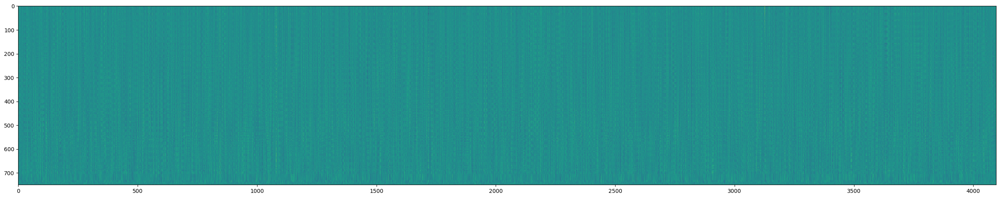

Filename: donatachi-2pop-reup-16m50s-sweat-drop_separated_vocals


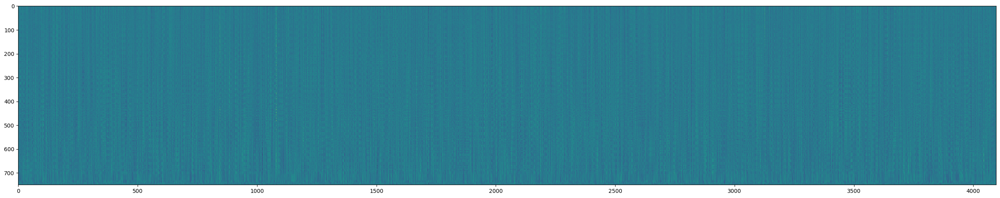

Filename: glacci-nest-10m-turns-to-love_separated_accompaniment


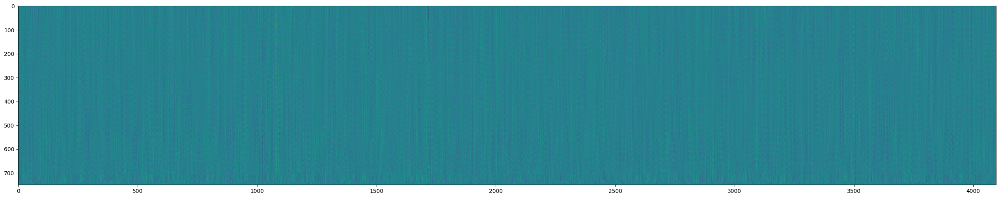

Filename: glacci-nest-10m-turns-to-love_separated_vocals


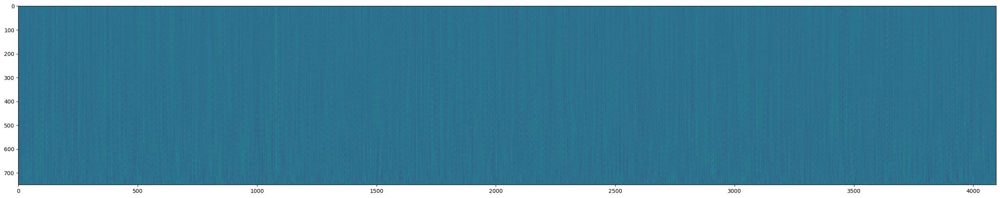

Filename: glacci-nest-10m-turns-to-love_10ms-clip_separated_accompaniment


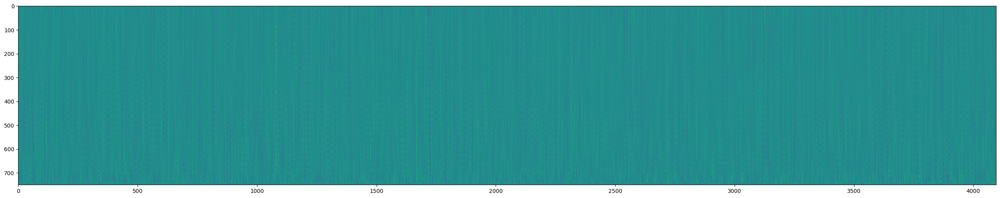

Filename: glacci-nest-10m-turns-to-love_10ms-clip_separated_vocals


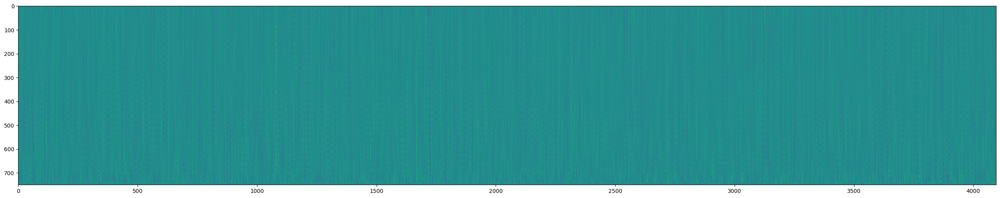

Filename: glacci-nest-10m-turns-to-love_2s-clip_separated_accompaniment


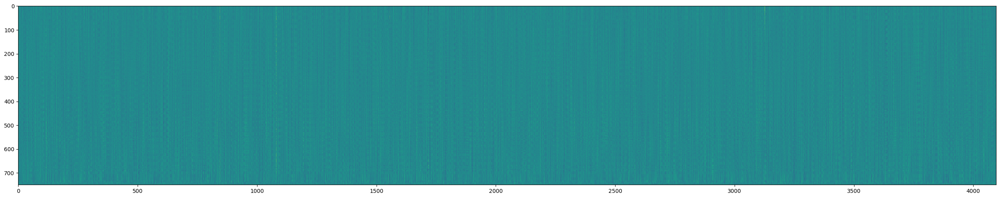

Filename: glacci-nest-10m-turns-to-love_2s-clip_separated_vocals


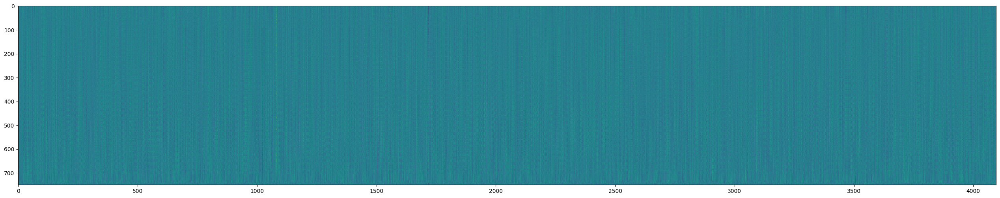

Filename: glacci-nest-10m-turns-to-love_8s-clip_separated_accompaniment


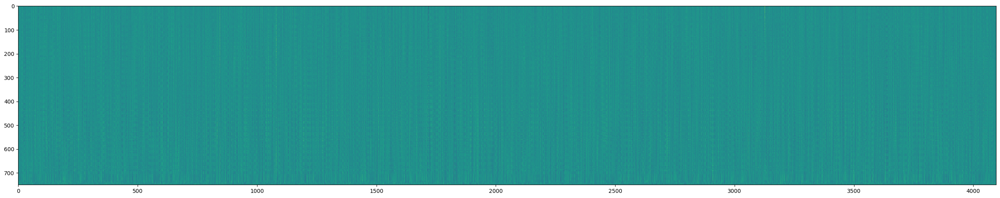

Filename: glacci-nest-10m-turns-to-love_8s-clip_separated_vocals


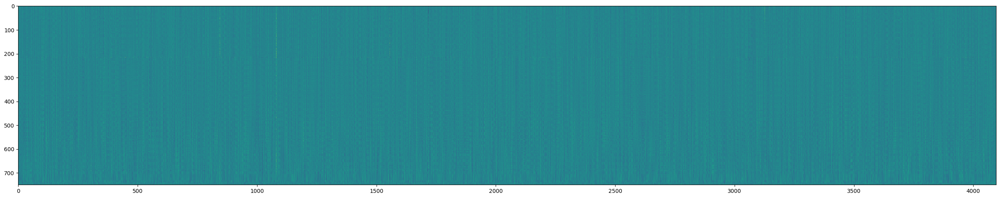

Filename: glacci-nest-10m-turns-to-love_13s-clip_separated_accompaniment


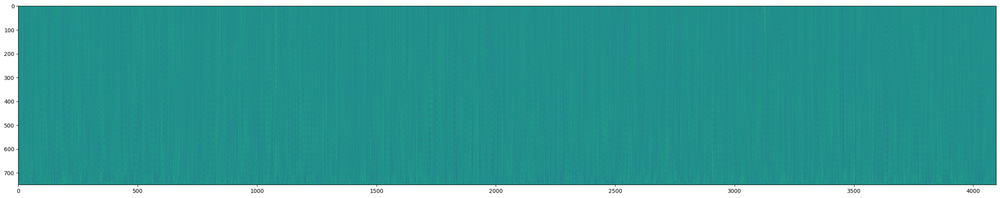

Filename: glacci-nest-10m-turns-to-love_13s-clip_separated_vocals


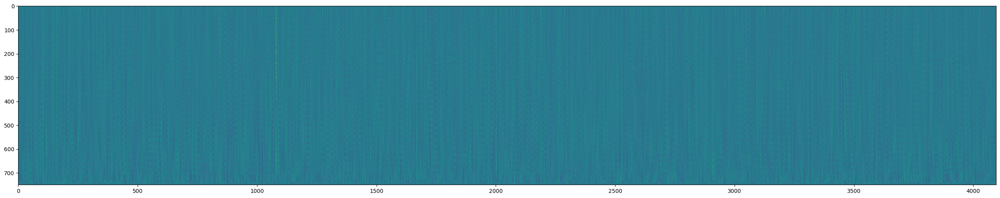

Filename: youtube_yXQViqx6GMY_audio_separated_accompaniment


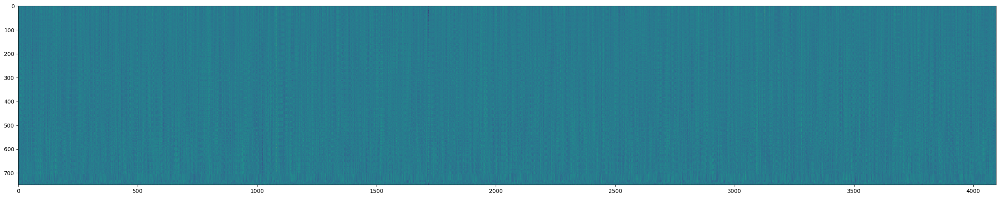

Filename: youtube_yXQViqx6GMY_audio_separated_vocals


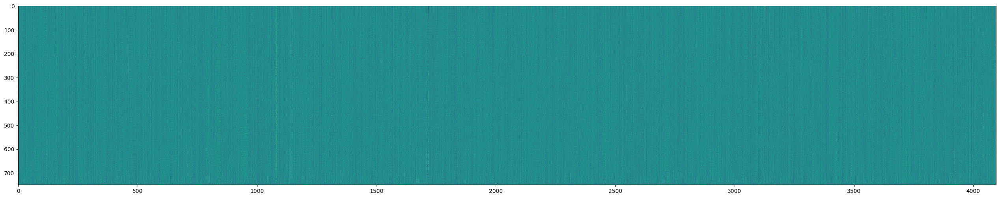

Filename: youtube_yXQViqx6GMY_audio_from-30s_separated_accompaniment


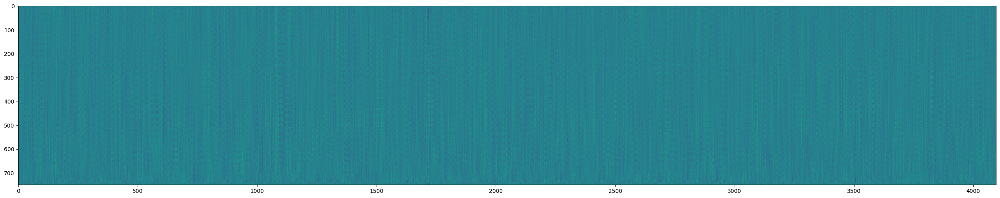

Filename: youtube_yXQViqx6GMY_audio_from-30s_separated_vocals


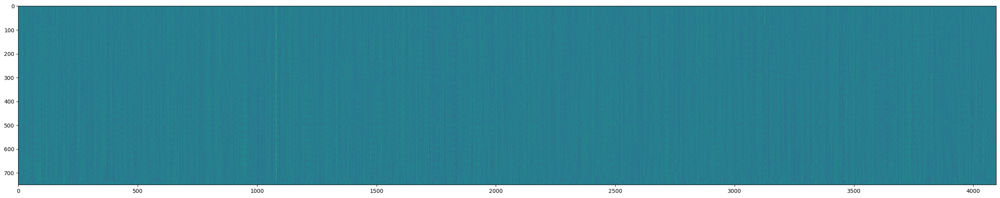

Filename: youtube_yXQViqx6GMY_audio_from-60s_separated_accompaniment


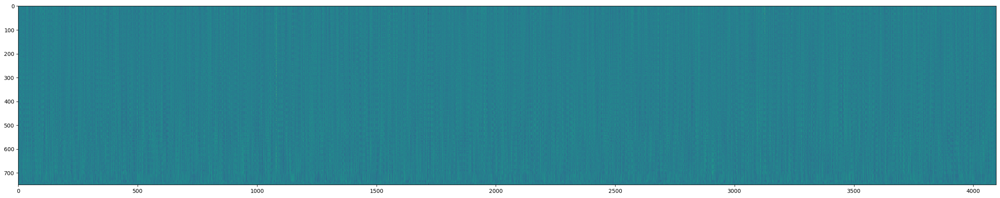

Filename: youtube_yXQViqx6GMY_audio_from-60s_separated_vocals


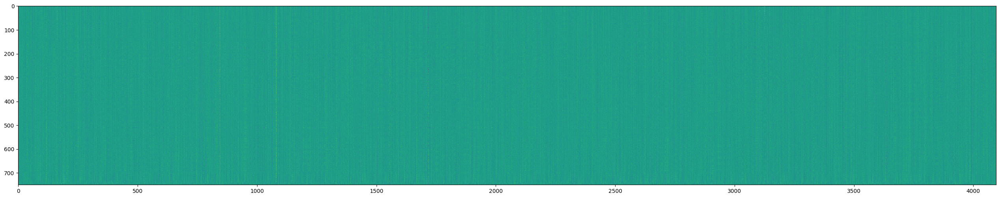

In [4]:
for emb in sorted(embs_dir.iterdir(), key=lambda x: parse_time(x.stem)):
    if emb.suffix == ".pt" and "separated" in emb.stem:
        print("Filename:", emb.stem)
        source_file = (mp3_dir / emb.stem).with_suffix(".mp3")
        warnings.simplefilter(action="ignore", category=FutureWarning)
        emb_pt = torch.load(emb)
        img = emb_pt["projected_outputs"].numpy()
        plt.figure(figsize=(16*2, 8*2))
        plt.imshow(img.squeeze())
        plt.savefig(figs_dir / f'projected_heatmap_plot_{emb.stem}.png', dpi=300, bbox_inches='tight')
        plt.show()

That wasn't very interesting to be honest... The only time this was clearly visible was in the pre-layer norm encoding output (when vertical columns could be discerned between the 1280D), it's smushed out of all visibility since the layernorm and now we've got the same in 4096D.

See the `umap_viz` notebook for something more interesting we can do to explore the multimodal projector features.